In [1]:
import sys
# sys.path.append('/Users/koush/Projects/Banksy_py')
sys.path.append('/ix/djishnu/alw399/SpaceOracle/src/Banksy_py')

import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [3]:
from banksy_utils.load_data import load_adata, display_adata

In [4]:
sample = 'lymph1'
adata = sc.read_h5ad(f'/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_{sample}_visiumHD.h5ad')
adata

AnnData object with n_obs × n_vars = 89296 × 2116
    obs: 'sample', 'cell_type', 'secondary_annot', 'cell_type_int'
    uns: 'cell_thresholds', 'cell_type_colors', 'neighbors', 'received_ligands', 'received_ligands_tfl', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_features', 'spatial_maps', 'spatial_unscaled'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [42]:
raw_x, raw_y = adata.obsm['spatial'][:, 0], adata.obsm['spatial'][:, 1]

In [43]:
adata.X = adata.layers['normalized_count']

In [44]:
adata.X.min(), adata.X.max()

(0.0, 5.698766010010265)

In [45]:
# display_adata(adata)

In [46]:
from banksy.main import median_dist_to_nearest_neighbour

In [47]:
plot_graph_weights = True
k_geom = 15 # number of spatial neighbours
max_m = 1 # use both mean and AFT
nbr_weight_decay = "scaled_gaussian" # can also choose "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours
nbrs = median_dist_to_nearest_neighbour(adata, key = 'spatial')


Median distance to closest cell = 11.16482892039516

---- Ran median_dist_to_nearest_neighbour in 0.61 s ----



In [48]:
adata.obs['x'] = raw_x
adata.obs['y'] = raw_y

In [49]:
from banksy.initialize_banksy import initialize_banksy

banksy_dict = initialize_banksy(
    adata,
    ('x', 'y', 'spatial'),
    k_geom,
    nbr_weight_decay=nbr_weight_decay,
    max_m=max_m,
    plt_edge_hist=False,
    plt_nbr_weights=False,
    plt_agf_angles=False, # takes long time to plot
    plt_theta=False,
)


Median distance to closest cell = 11.16482892039516

---- Ran median_dist_to_nearest_neighbour in 0.57 s ----

---- Ran generate_spatial_distance_graph in 1.22 s ----

---- Ran row_normalize in 0.33 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 3.20 s ----

---- Ran generate_spatial_distance_graph in 1.73 s ----

---- Ran theta_from_spatial_graph in 0.98 s ----

---- Ran row_normalize in 0.31 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 4.62 s ----



In [59]:
from banksy.embed_banksy import generate_banksy_matrix

# The following are the main hyperparameters for BANKSY
# -----------------------------------------------------
resolutions = [0.8]  # clustering resolution for UMAP
pca_dims = [50]  # Dimensionality in which PCA reduces to
lambda_list = [0.2]  # list of lambda parameters

banksy_dict, banksy_matrix = generate_banksy_matrix(adata,
                                                    banksy_dict,
                                                    lambda_list,
                                                    max_m)
banksy_matrix

Runtime Jun-23-2025-15-47

6348 genes to be analysed:
Gene List:
Index(['Adam11', 'Adam12', 'Adam23', 'Adam8', 'Adamts10', 'Adap1', 'Adcy6',
       'Adgre4', 'Adgre5', 'Adgrg6',
       ...
       'Zkscan6_nbr_1', 'Zmat3_nbr_1', 'Zmat5_nbr_1', 'Zmym1_nbr_1',
       'Zmynd11_nbr_1', 'Zmynd12_nbr_1', 'Zmynd15_nbr_1', 'Znfx1_nbr_1',
       'Znhit2_nbr_1', 'Zup1_nbr_1'],
      dtype='object', length=6348)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <92969x92969 sparse matrix of type '<class 'numpy.float64'>'
	with 1394535 stored elements in Compressed Sparse Row format>, 1: <92969x92969 sparse matrix of type '<class 'numpy.complex128'>'
	with 2789070 stored elements in Compressed Sparse Row format>}, 'norm_counts_concatenated': array([[0.46952943, 0.        , 0.        , ..., 0.05311362, 0.        ,
        0.03712021],
       [0.        , 0.        , 0.        , ..., 0.03170432, 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.00595829, 0

/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


KeyError: 'weights'

In [51]:
outdir = '/ix/djishnu/shared/djishnu_kor11/banksy_outputs'
banksy_matrix.to_df().to_parquet(f'{outdir}/mouse_{sample}_visiumHD_banksy_embedding.parquet')

In [52]:
from banksy.main import concatenate_all

banksy_dict["nonspatial"] = {
    # Here we simply append the nonspatial matrix (adata.X) to obtain the nonspatial clustering results
    0.0: {"adata": concatenate_all([adata.X], 0, adata=adata), }
}

print(banksy_dict['nonspatial'][0.0]['adata'])

Scale factors squared: [1.]
Scale factors: [1.]


AnnData object with n_obs × n_vars = 92969 × 2116
    obs: 'cell_type', 'secondary_annot', 'cell_type_int', 'x', 'y'
    var: 'is_nbr', 'k'


In [ ]:
from banksy_utils.umap_pca import pca_umap

pca_umap(
    banksy_dict,
    pca_dims = pca_dims,
    add_umap = True,
    plt_remaining_var = False,
)

Current decay types: ['scaled_gaussian', 'nonspatial']

Reducing dims of dataset in (Index = scaled_gaussian, lambda = 0.2)

Setting the total number of PC = 50
Original shape of matrix: (92969, 6348)
Reduced shape of matrix: (92969, 50)
------------------------------------------------------------
min_value = -13.267640518777089, mean = -2.801908714426732e-16, max = 17.199001572470422

Conducting UMAP and adding embeddings to adata.obsm["reduced_pc_50_umap"]
UMAP embedding
------------------------------------------------------------
shape: (92969, 2)


AxisArrays with keys: reduced_pc_50, reduced_pc_50_umap

Reducing dims of dataset in (Index = nonspatial, lambda = 0.0)

Setting the total number of PC = 50
Original shape of matrix: (92969, 2116)
Reduced shape of matrix: (92969, 50)
------------------------------------------------------------
min_value = -14.953444748087367, mean = -1.788000633115688e-16, max = 17.140159951161863

Conducting UMAP and adding embeddings to adata.obsm["red

In [54]:
from banksy.cluster_methods import run_Leiden_partition

results_df, max_num_labels = run_Leiden_partition(
    banksy_dict,
    resolutions,
    num_nn = 50, # k_expr: number of neighbours in expression (BANKSY embedding or non-spatial) space
    num_iterations = -1, # run to convergenece
    partition_seed = 42,
    match_labels = True,
)

Decay type: scaled_gaussian
Neighbourhood Contribution (Lambda Parameter): 0.2
reduced_pc_50 

reduced_pc_50_umap 

PCA dims to analyse: [50]

Setting up partitioner for (nbr decay = scaled_gaussian), Neighbourhood contribution = 0.2, PCA dimensions = 50)


Nearest-neighbour weighted graph (dtype: float64, shape: (92969, 92969)) has 4648450 nonzero entries.
---- Ran find_nn in 639.92 s ----


Nearest-neighbour connectivity graph (dtype: int16, shape: (92969, 92969)) has 4648450 nonzero entries.

(after computing shared NN)
Allowing nearest neighbours only reduced the number of shared NN from 570418389 to 4486263.


Shared nearest-neighbour (connections only) graph (dtype: int16, shape: (92969, 92969)) has 2405186 nonzero entries.

Shared nearest-neighbour (number of shared neighbours as weights) graph (dtype: int16, shape: (92969, 92969)) has 2405186 nonzero entries.

sNN graph data:
[10  8  5 ...  6  5  8]

---- Ran shared_nn in 23.60 s ----


-- Multiplying sNN connectivity by weight

/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/labels.py:398: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  expand_labels(label_list[sort_indices[0]],
/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/labels.py:414: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  current_label = label_list[index]


,decay,lambda_param,num_pcs,resolution,num_labels,labels,adata,relabeled
nonspatial_pc50_nc0.00_r0.60,nonspatial,0.0,50,0.6,48,"Label object:\nNumber of labels: 48, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 48, number of..."
scaled_gaussian_pc50_nc0.20_r0.60,scaled_gaussian,0.2,50,0.6,34,"Label object:\nNumber of labels: 34, number of...",[[[View of AnnData object with n_obs × n_vars ...,"Label object:\nNumber of labels: 34, number of..."


number of labels: 48
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 48
---- Ran plot_2d_embeddings in 0.02 s ----

number of labels: 48
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((48, 92969) x (92969, 92969) x (92969, 48))

number of labels: 34
---- Ran plot_2d_embeddings in 0.00 s ----

number of labels: 34
---- Ran plot_2d_embeddings in 0.01 s ----

number of labels: 34
---- Ran plot_2d_embeddings in 0.00 s ----

---- Ran row_normalize in 0.00 s ----


matrix multiplying labels x weights x labels-transpose ((34, 92969) x (92969, 92969) x (92969, 34))



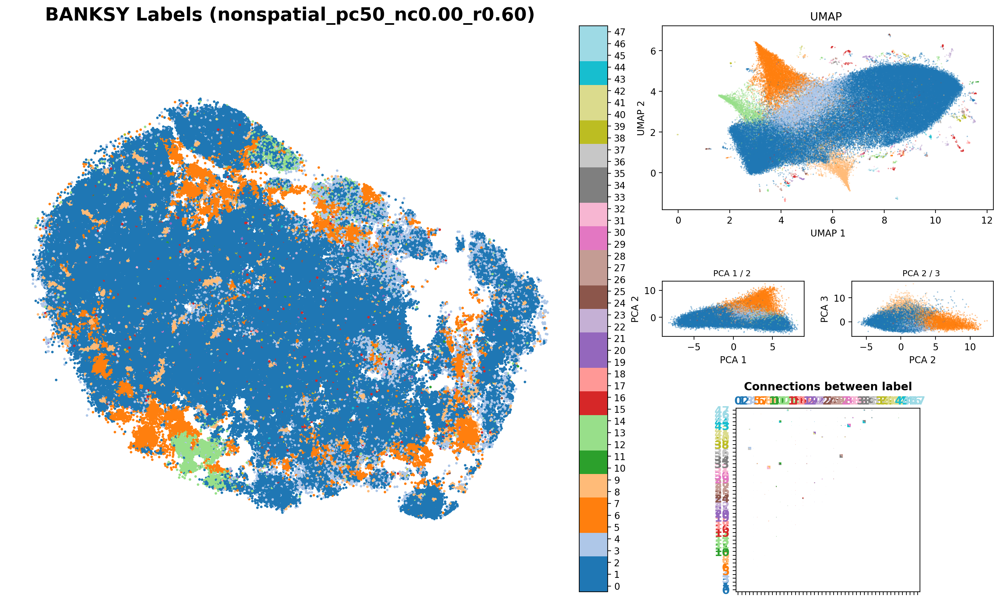

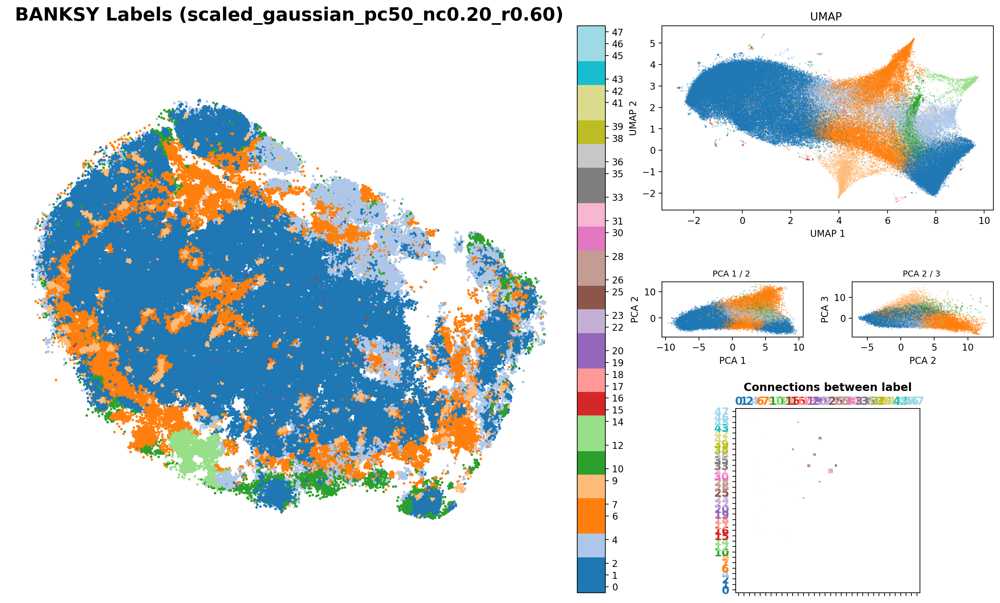

In [55]:
from banksy.plot_banksy import plot_results

c_map =  'tab20' # specify color map
weights_graph =  banksy_dict['scaled_gaussian']['weights'][0]

plot_results(
    results_df,
    weights_graph,
    c_map,
    match_labels = True,
    coord_keys = ('x', 'y', 'spatial'),
    max_num_labels  =  max_num_labels, 
    save_path = '/tmp',
    save_fig = False
)

In [56]:
atmp = results_df.adata[1].copy()
atmp

/tmp/ipykernel_79649/3796968393.py:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  atmp = results_df.adata[1].copy()


AnnData object with n_obs × n_vars = 92969 × 6348
    obs: 'cell_type', 'secondary_annot', 'cell_type_int', 'x', 'y', 'labels_scaled_gaussian_pc50_nc0.20_r0.60'
    var: 'is_nbr', 'k'
    obsm: 'reduced_pc_50', 'reduced_pc_50_umap', 'spatial'

In [ ]:
adata = results_df.loc['scaled_gaussian_pc50_nc0.20_r0.60', 'adata']

df = pd.concat([pd.DataFrame(adata.obsm['reduced_pc_50_umap'], index=adata.obs_names, columns=['x_umap', 'y_umap']), adata.obs['labels_scaled_gaussian_pc50_nc0.20_r0.60']], axis=1)
df.to_csv(f'/ix/djishnu/shared/djishnu_kor11/banksy_outputs/mouse_{sample}_visiumHD_banksy_celltypes.csv')

### Plot

In [5]:
banksy_df = pd.read_csv('/ix/djishnu/shared/djishnu_kor11/banksy_outputs/mouse_lymph1_visiumHD_banksy_celltypes.csv', index_col=0)
banksy_df.index = banksy_df.index.astype(str)

adata.obs = pd.concat([adata.obs, banksy_df], axis=1)
adata.obs.head(3)

,sample,cell_type,secondary_annot,cell_type_int,x_umap,y_umap,banksy_cluster
object_id,,,,,,,
247819,unmatched,B,NaN,0,-1.589480,-0.168589,0
200373,unmatched,CD8+ T,Tfh,1,7.992571,-1.810663,3
190000,unmatched,B,NaN,0,1.204481,0.755010,7


In [6]:
adata.obs.cell_type.value_counts()

cell_type
B            67597
CD8+ T        9148
Resting T     6991
DC            1807
Treg          1607
Tfh           1060
Th2            433
gd T           362
NK             291
Name: count, dtype: int64

In [9]:
b_counts = adata.obs['banksy_cluster'].value_counts()
adata.obs['banksy_cluster'] = [x if b_counts[x] > 100 else 'other' for x in adata.obs['banksy_cluster']]
adata.obs['banksy_cluster'] = adata.obs['banksy_cluster'].astype('category')

In [10]:
colors = [
    "#6581d8",
    "#ac9c3d",
    "#573789",
    "#56ae6c",
    "#b551a0",
    "#ba543d",
    "#bd80d6",
    "#b94a73"
]

color_dict = {x: colors[i] for i, x in enumerate(adata.obs['banksy_cluster'].unique())}

In [16]:
adata.obs['x'] = adata.obsm['spatial'][:, 0]
adata.obs['y'] = adata.obsm['spatial'][:, 1]

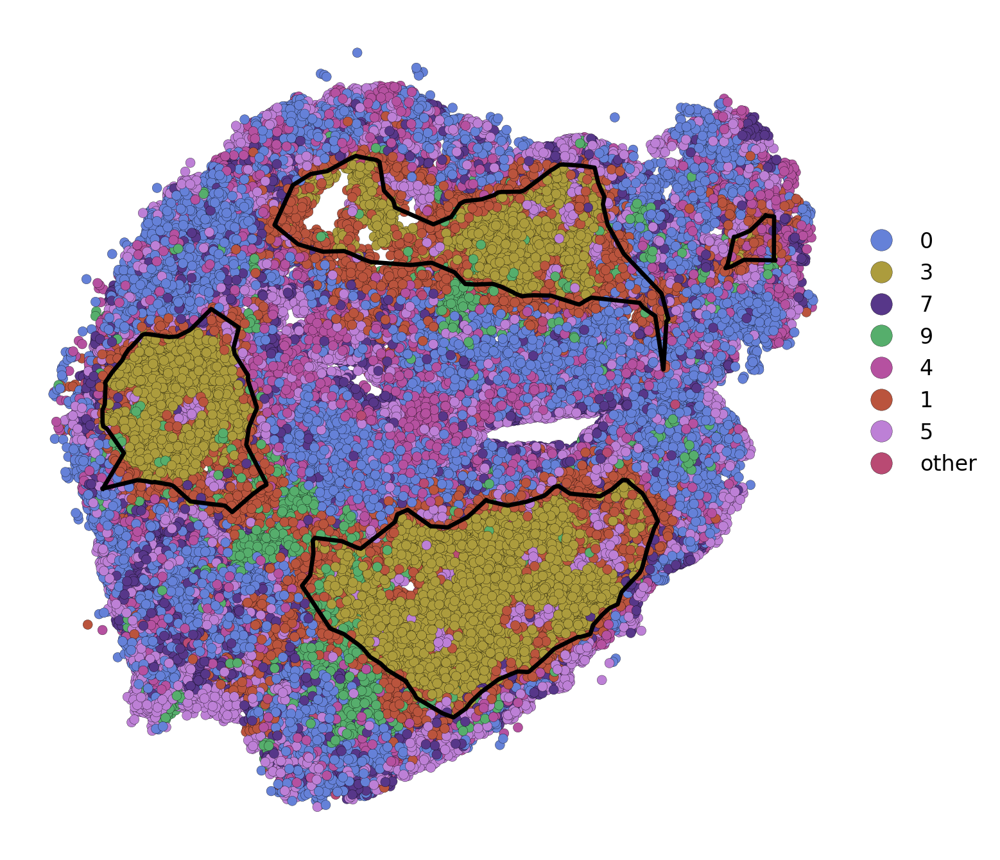

In [31]:
import alphashape
import numpy as np 

plt.rcParams['figure.figsize'] = (9.25, 9)
plt.rcParams['figure.dpi'] = 120

f, ax = plt.subplots(1, 1, figsize=(7, 7), dpi=120)

# Get points for cluster 3
cluster3_points = np.asarray(adata[adata.obs['banksy_cluster'] == 3].obsm['spatial'])

# Create alpha shape for cluster 3
if len(cluster3_points) > 0:
    alpha_shape = alphashape.alphashape(cluster3_points, alpha=0.005)
    
    # Plot the boundary if it's a valid geometry
    if hasattr(alpha_shape, 'geoms'):
        # MultiPolygon case
        for geom in alpha_shape.geoms:
            if hasattr(geom, 'exterior'):
                coords = np.array(geom.exterior.coords)
                ax.plot(coords[:, 0], coords[:, 1], 'k', linewidth=2)
    elif hasattr(alpha_shape, 'exterior'):
        # Single Polygon case
        coords = np.array(alpha_shape.exterior.coords)
        ax.plot(coords[:, 0], coords[:, 1], 'k', linewidth=2)

# Create scatter plot
g = sns.scatterplot(
    data=adata.obs, ax=ax,
    x='x', y='y', hue='banksy_cluster', s=20,
    legend=True, palette=color_dict, alpha=1,
    edgecolor='black', linewidth=0.1
)

# Fix legend ordering
handles, labels = g.get_legend_handles_labels()
label_handle_map = dict(zip(labels, handles))
ordered_handles = [label_handle_map[str(key)] for key in color_dict.keys()]
plt.legend(handles=ordered_handles, labels=color_dict.keys(), 
          bbox_to_anchor=(1, 0.75), loc='upper left',
          borderaxespad=0., frameon=False, fontsize=10, markerscale=2.25)

plt.gca().set_frame_on(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('')
plt.ylabel('')
plt.show()

### Banksy SLIDE

In [5]:
sample = 'lymph1'
adata = sc.read_h5ad(f'/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_{sample}_visiumHD.h5ad')
adata

AnnData object with n_obs × n_vars = 89296 × 2116
    obs: 'sample', 'cell_type', 'secondary_annot', 'cell_type_int'
    uns: 'cell_thresholds', 'cell_type_colors', 'neighbors', 'received_ligands', 'received_ligands_tfl', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_features', 'spatial_maps', 'spatial_unscaled'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [6]:
banksy_df = pd.read_csv('/ix/djishnu/shared/djishnu_kor11/banksy_outputs/mouse_lymph1_visiumHD_banksy_celltypes.csv', index_col=0)
banksy_df.index = banksy_df.index.astype(str)

adata.obs = pd.concat([adata.obs, banksy_df], axis=1)
adata.obs.head(3)

,sample,cell_type,secondary_annot,cell_type_int,x_umap,y_umap,banksy_cluster
object_id,,,,,,,
247819,unmatched,B,NaN,0,-1.589480,-0.168589,0
200373,unmatched,CD8+ T,Tfh,1,7.992571,-1.810663,3
190000,unmatched,B,NaN,0,1.204481,0.755010,7


In [7]:
adata = adata[adata.obs['cell_type'] == 'Th2']
adata.obs['y'] = [1 if x == 3 else 0 for x in adata.obs['banksy_cluster']]
adata.obs['y'].value_counts()

/tmp/ipykernel_20378/2090454434.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['y'] = [1 if x == 3 else 0 for x in adata.obs['banksy_cluster']]


y
0    231
1    202
Name: count, dtype: int64

In [ ]:
import sys 
sys.path.append('/ix3/djishnu/alw399/SLIDE_py/src')

from loveslide.slide import OptimizeSLIDE

input_params = {
    'fdr' : 0.1,
    'thresh_fdr': 0.1,
    'spec' : 0.2,
    'y_factor': True,
    'niter' : 500,
    'SLIDE_top_feats': 20,
    'pure_homo' : True,
    'delta' : [0.01, 0.1],
    'lambda' : [0.1, 0.5],
    'out_path': 'banksy_slide_outs',
}

x = adata.to_df(layer='normalized_count')
y = adata.obs['y']

slide = OptimizeSLIDE(
    input_params=input_params,
    x=x, y=y
)

slide.run_pipeline()


### PARAMETERS ###

fdr: 0.1
thresh_fdr: 0.1
spec: 0.2
y_factor: True
niter: 500
SLIDE_top_feats: 20
pure_homo: True
delta: [0.01, 0.1]
lambda: [0.1, 0.5]
out_path: banksy_slide_outs
x_path: None
y_path: None
n_workers: 1
do_interacts: True

###### DATA ######

433 samples
2116 features
46.7% cases
53.3% controls

##################

Running LOVE with delta=0.01 and lambda=0.1


R[write to console]: 




Error running LOVE: 

##################

Running LOVE with delta=0.01 and lambda=0.5
